**This notebook made from [Theo Viel](https://www.kaggle.com/theoviel)'s [notebook](https://www.kaggle.com/theoviel/spectrogram-generation) and [discussion](https://www.kaggle.com/c/rfcx-species-audio-detection/discussion/198048).**
Thanks.


I try to remove noise by using the Sound Envelope from the [previous competition discussion](https://www.kaggle.com/c/birdsong-recognition/discussion/169582#946072).  
This notebook generates denoised spectrograms.  
The calculated dataset is [here](https://www.kaggle.com/takamichitoda/rfcx-denoise-melspec).

# Install denoise library

I use [noisereduce library](https://pypi.org/project/noisereduce/).

In [2]:
!pip install noisereduce

Defaulting to user installation because normal site-packages is not writeable
  Created wheel for noisereduce: filename=noisereduce-1.1.0-py3-none-any.whl size=7608 sha256=baea1e063e31fca7c191dc5fc15cc0b0b33a736298e9a9ca7dadf0a3d491496c
  Stored in directory: /home/user/.cache/pip/wheels/a9/d4/51/49c94295d30569d64c83dc11dce56166173635c85d060c9859
Successfully built noisereduce
You should consider upgrading via the '/usr/bin/python3 -m pip install --upgrade pip' command.


# Import Python Library

In [1]:
import os
import shutil
import  joblib
import numpy as np
import pandas as pd
import librosa as lb
import librosa.display
import matplotlib.pyplot as plt

from pathlib import Path
from tqdm import tqdm
import IPython.display
import soundfile as sf

import noisereduce as nr
from matplotlib import pyplot as plt
from scipy.ndimage import maximum_filter1d

/home/user/.local/lib/python3.6/site-packages/noisereduce/noisereduce.py:5: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import tqdm


# Data

In [2]:
INPUT_ROOT = Path("/home/knikaido/work/Rainforest-Connection/data")
RAW_DATA = INPUT_ROOT / "rfcx-species-audio-detection"
TRAIN_AUDIO_ROOT = RAW_DATA / "train"
TEST_AUDIO_ROOT = RAW_DATA / "test"

In [3]:
df_train = pd.DataFrame({
    "recording_id": [path.stem for path in Path(TRAIN_AUDIO_ROOT).glob("*.flac")],
})

df_test = pd.DataFrame({
    "recording_id": [path.stem for path in Path(TEST_AUDIO_ROOT).glob("*.flac")],
})

# Tools

In [4]:
class params:
    """
    Parameters used for the audio data
    """
    sr = 48000

    # Melspectrogram
    n_mels = 128
    fmin = 20
    fmax = sr // 2  # Shannon theorem

In [5]:
def load_audio(record, sr=48000, root=""):
    y, _ = lb.load(
        root.joinpath(record).with_suffix(".flac").as_posix(),
        sr=sr, 
    )
    return y

In [6]:
def compute_melspec(y, params):
    """
    Computes a mel-spectrogram and puts it at decibel scale
    Arguments:
        y {np array} -- signal
        params {AudioParams} -- Parameters to use for the spectrogram. Expected to have the attributes sr, n_mels, f_min, f_max
    Returns:
        np array -- Mel-spectrogram
    """
    melspec = lb.feature.melspectrogram(
        y, sr=params.sr, n_mels=params.n_mels, fmin=params.fmin, fmax=params.fmax,
    )

    melspec = lb.power_to_db(melspec).astype(np.float32)
    return melspec

# Example

original sound

In [7]:
y = load_audio(df_train["recording_id"][0], params.sr, TRAIN_AUDIO_ROOT)
IPython.display.Audio(y, rate=params.sr)

## Denoise

I detect point no birdcall by using Sound Envelope.

In [8]:
def envelope(y, rate, threshold):
    mask = []
    y_mean = maximum_filter1d(np.abs(y), mode="constant", size=rate//20)
    for mean in y_mean:
        if mean > threshold:
            mask.append(True)
        else:
            mask.append(False)
    return mask, y_mean

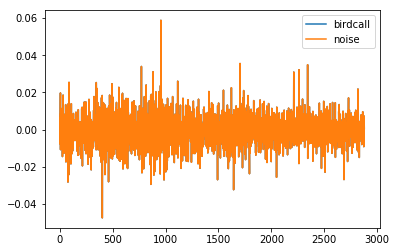

In [27]:
thr = 0.1
mask, env = envelope(y, params.sr, thr)

plt.plot(y[::1000], label="birdcall")
plt.plot(y[np.logical_not(mask)][::1000], label="noise")
plt.legend(bbox_to_anchor=(1, 1), loc='upper right')

denoise and check denoise sound

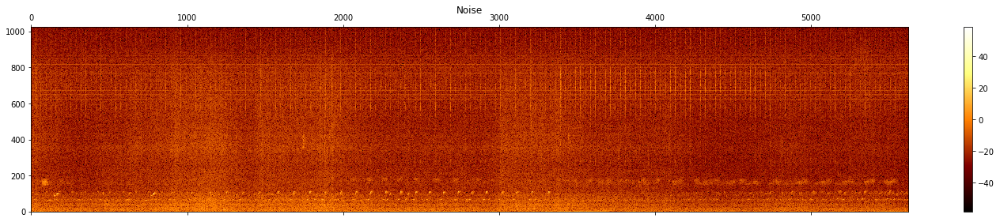

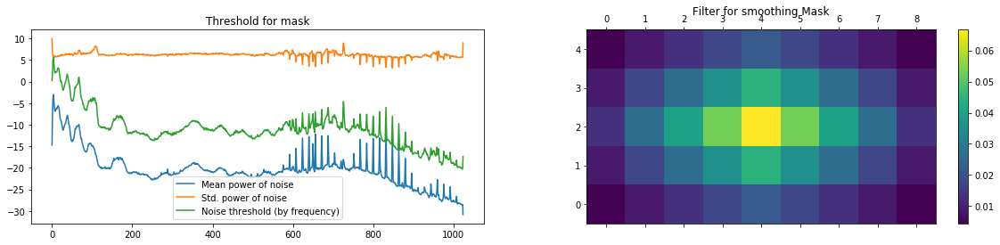

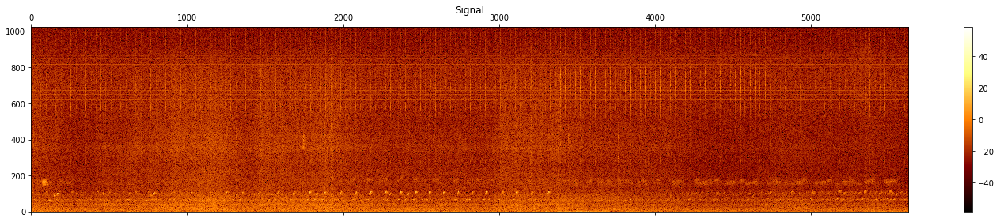

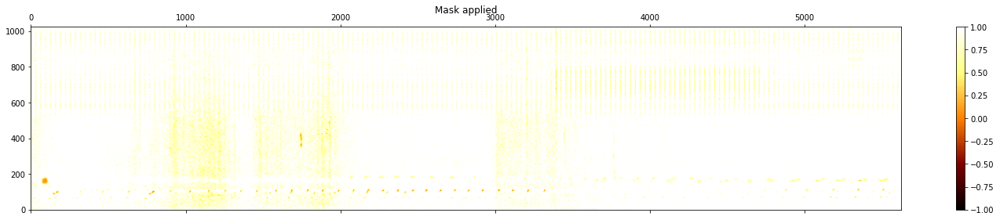

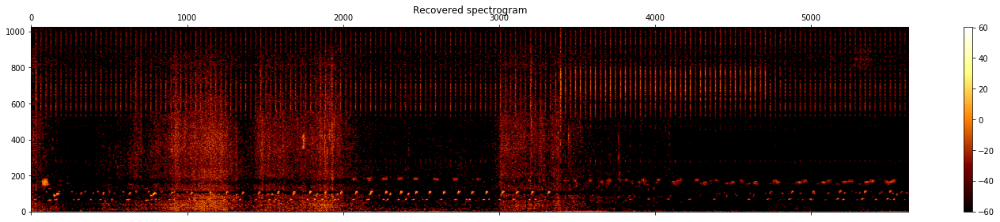

In [28]:
y_denoise = nr.reduce_noise(audio_clip=y, noise_clip=y[np.logical_not(mask)], verbose=True)

compare original sound spectrum and denoise sound spectrum.

In [29]:
IPython.display.Audio(y_denoise, rate=params.sr)

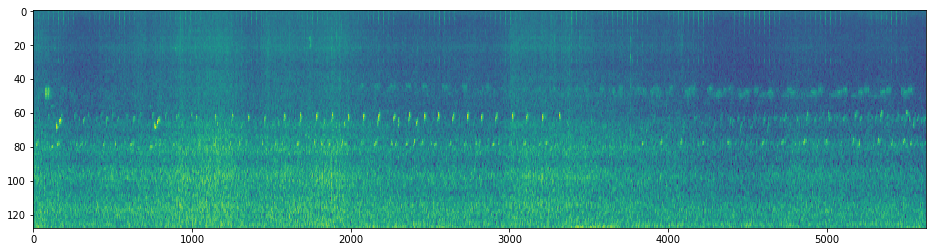

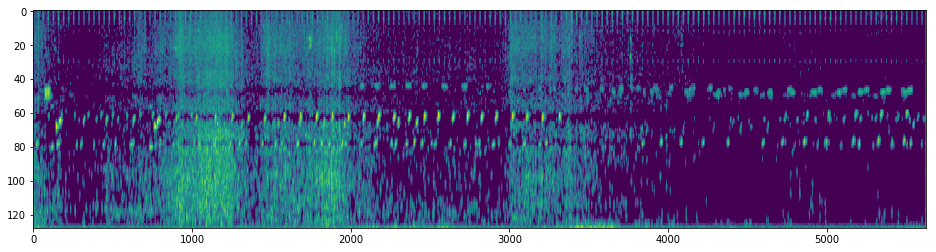

In [34]:
def tmp_audio_to_spec(audio, sr):
    spec = librosa.power_to_db(
        librosa.feature.melspectrogram(audio, sr=sr, fmin=20, fmax=16000, n_mels=128)
    )
    return np.flipud(spec.astype(np.float32))

plt.figure(figsize=(16, 4))
plt.imshow(tmp_audio_to_spec(y, params.sr))
plt.axes().set_aspect('auto')
plt.show()

plt.figure(figsize=(16, 4))
plt.imshow(tmp_audio_to_spec(y_denoise, params.sr))
plt.axes().set_aspect('auto')
plt.show()

In [35]:
y_harm, y_perc = librosa.effects.hpss(y, margin=(1.0,5.0))

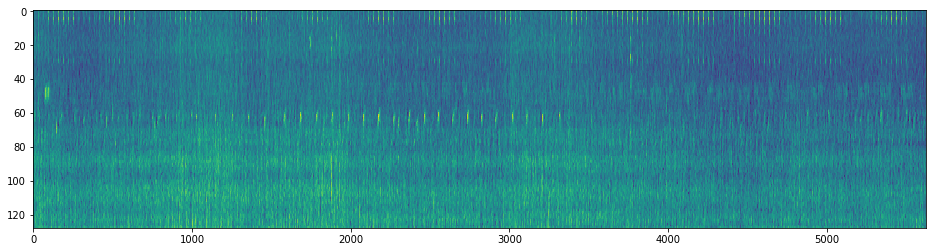

In [36]:
plt.figure(figsize=(16, 4))
plt.imshow(tmp_audio_to_spec(y_perc, params.sr))
plt.axes().set_aspect('auto')
plt.show()

In [33]:
IPython.display.Audio(y_perc, rate=params.sr)

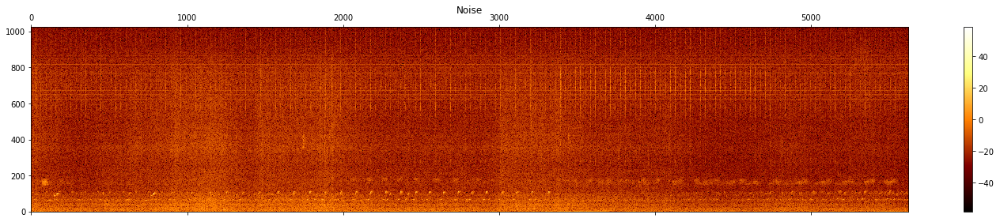

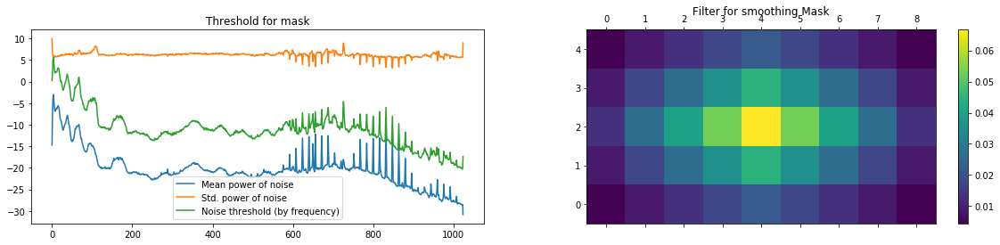

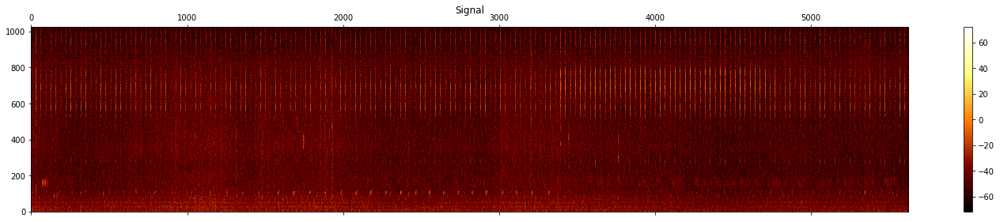

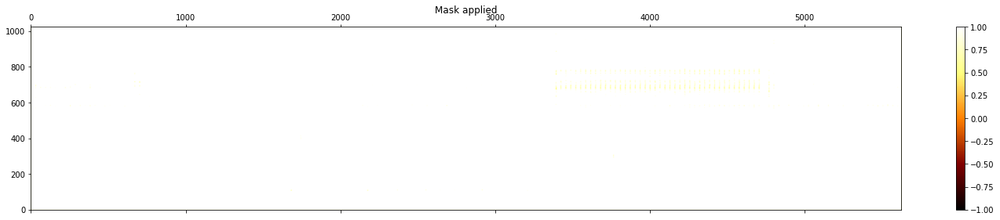

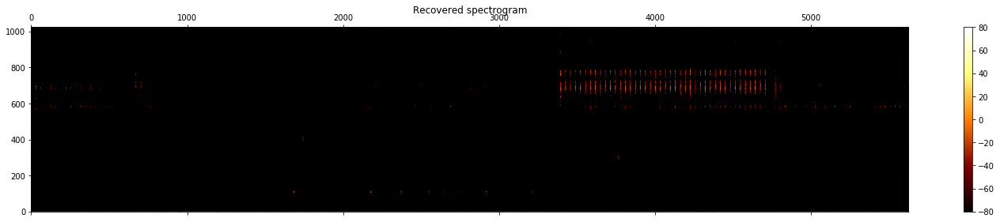

In [37]:
y_denoise_perc = nr.reduce_noise(audio_clip=y_perc, noise_clip=y[np.logical_not(mask)], verbose=True)

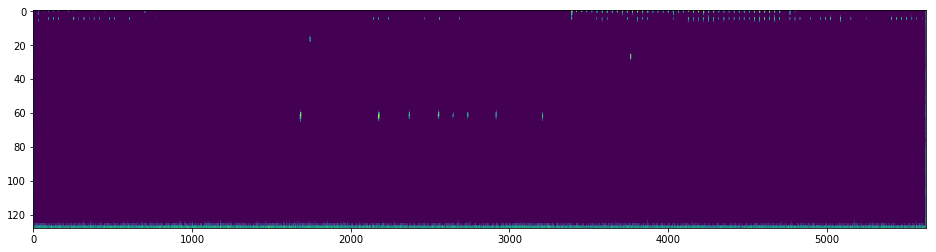

In [39]:
plt.figure(figsize=(16, 4))
plt.imshow(tmp_audio_to_spec(y_denoise_perc, params.sr))
plt.axes().set_aspect('auto')
plt.show()

In [40]:
IPython.display.Audio(y_denoise_perc, rate=params.sr)

It seems that noise has been removed.

# Main

## Train

In [19]:
def load_and_save_train(record):
    y = load_audio(record, params.sr, TRAIN_AUDIO_ROOT)
    # denoise
    mask, env = envelope(y, 32000, thr)
    noise_clip = y[np.logical_not(mask)]
    if len(noise_clip):
        y = nr.reduce_noise(audio_clip=y, noise_clip=noise_clip, verbose=False)
#     melspec = compute_melspec(y, params)
    sf.write(OUT_TRAIN + '/' +  record+'_denoise.flac', y, params.sr)
    
#     np.save(OUT_TRAIN + record + ".npy", melspec)

In [20]:
OUT_TRAIN = str(RAW_DATA / 'train_denoise')
OUT_TRAIN_PATH = RAW_DATA / 'train_denoise'
# os.mkdir(OUT_TRAIN)

In [22]:
_ = joblib.Parallel(n_jobs=8)(
    joblib.delayed(load_and_save_train)(record) for record in tqdm(df_train['recording_id'].values)
)

100%|██████████| 4727/4727 [50:59<00:00,  1.55it/s]


In [ ]:
shutil.make_archive(OUT_TRAIN, 'zip', OUT_TRAIN)
shutil.rmtree(OUT_TRAIN)

## Test

In [33]:
def load_and_save_test(record):
    y = load_audio(record, params.sr, TEST_AUDIO_ROOT)
    melspec = compute_melspec(y, params)

    np.save(OUT_TEST + record + ".npy", melspec)
    
    
def load_and_save_test(record):
    y = load_audio(record, params.sr, TEST_AUDIO_ROOT)
    # denoise
    mask, env = envelope(y, 32000, thr)
    noise_clip = y[np.logical_not(mask)]
    if len(noise_clip):
        y = nr.reduce_noise(audio_clip=y, noise_clip=noise_clip, verbose=False)
#     melspec = compute_melspec(y, params)
    sf.write(OUT_TEST + '/' +  record+'_denoise.flac', y, params.sr)

In [34]:
OUT_TEST = str(RAW_DATA / 'test_denoise')
OUT_TEST_PATH = RAW_DATA / 'test_denoise'
# OUT_TEST = 'test/'
# os.mkdir(OUT_TEST)

In [35]:
_ = joblib.Parallel(n_jobs=8)(
    joblib.delayed(load_and_save_test)(record) for record in tqdm(df_test['recording_id'].values)
)



  0%|          | 0/1992 [00:00<?, ?it/s]

  1%|          | 16/1992 [00:06<13:40,  2.41it/s]

  1%|          | 24/1992 [00:09<13:38,  2.40it/s]

  2%|▏         | 32/1992 [00:14<15:01,  2.17it/s]

  2%|▏         | 40/1992 [00:18<15:57,  2.04it/s]

  2%|▏         | 48/1992 [00:23<16:30,  1.96it/s]

  3%|▎         | 56/1992 [00:27<16:56,  1.90it/s]

  3%|▎         | 64/1992 [00:32<17:09,  1.87it/s]

  4%|▎         | 72/1992 [00:37<17:50,  1.79it/s]

  4%|▍         | 80/1992 [00:42<18:35,  1.71it/s]

  4%|▍         | 88/1992 [00:47<19:03,  1.67it/s]

  5%|▍         | 96/1992 [00:53<19:54,  1.59it/s]

  5%|▌         | 104/1992 [00:58<19:57,  1.58it/s]

  6%|▌         | 112/1992 [01:03<19:53,  1.58it/s]

  6%|▌         | 120/1992 [01:08<19:56,  1.56it/s]

  6%|▋         | 128/1992 [01:13<19:45,  1.57it/s]

  7%|▋         | 136/1992 [01:18<19:35,  1.58it/s]

  7%|▋         | 144/1992 [01:24<19:57,  1.54it/s]

  8%|▊         | 152/1992 [01:29<19:49,  1.55it/s]

  8%|▊         | 160/1992 [01:3

In [ ]:
shutil.make_archive(OUT_TEST, 'zip', OUT_TEST)
shutil.rmtree(OUT_TEST)